In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score, silhouette_samples, rand_score, adjusted_rand_score

## Data cleaning

In [3]:
df = pd.read_csv("dataset.csv")
df.head()

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,...,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4,acoustic
1,1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,...,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4,acoustic
2,2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,...,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4,acoustic
3,3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,...,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3,acoustic
4,4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,...,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4,acoustic


In [4]:
# Checking for NA values in each column
df.isna().sum()

Unnamed: 0          0
track_id            0
artists             1
album_name          1
track_name          1
popularity          0
duration_ms         0
explicit            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
time_signature      0
track_genre         0
dtype: int64

In [5]:
# Cleaning the data
def clean_spotify(df):
   df_clean = df.dropna()

   # One hot encoding
   df_clean = pd.get_dummies(df_clean, columns=["explicit", "track_genre"],
                             dtype=int, drop_first=True)

   df_clean = df_clean.drop(["Unnamed: 0", "track_id"], axis = 1)

   return df_clean

df_clean = clean_spotify(df)
df_clean.head()

,artists,album_name,track_name,popularity,duration_ms,danceability,energy,key,loudness,mode,...,track_genre_spanish,track_genre_study,track_genre_swedish,track_genre_synth-pop,track_genre_tango,track_genre_techno,track_genre_trance,track_genre_trip-hop,track_genre_turkish,track_genre_world-music
0,Gen Hoshino,Comedy,Comedy,73,230666,0.676,0.4610,1,-6.746,0,...,0,0,0,0,0,0,0,0,0,0
1,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,0.420,0.1660,1,-17.235,1,...,0,0,0,0,0,0,0,0,0,0
2,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,0.438,0.3590,0,-9.734,1,...,0,0,0,0,0,0,0,0,0,0
3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,0.266,0.0596,0,-18.515,1,...,0,0,0,0,0,0,0,0,0,0
4,Chord Overstreet,Hold On,Hold On,82,198853,0.618,0.4430,2,-9.681,1,...,0,0,0,0,0,0,0,0,0,0


## EDA

Text(0.5, 1.0, 'Correlation Matrix')

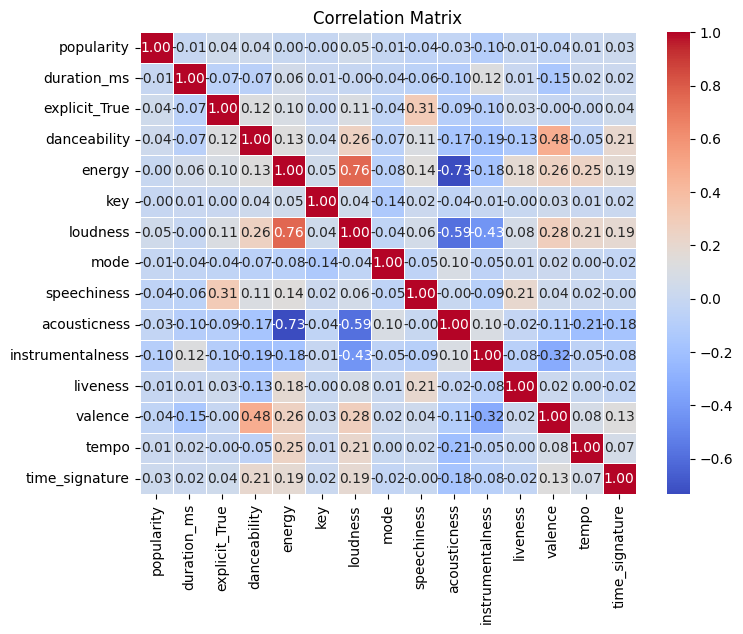

In [6]:
# Correlation matrix excluding genres
no_genres = ['popularity', 'duration_ms', 'explicit_True', 'danceability',
             'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness',
             'instrumentalness', 'liveness', 'valence', 'tempo', 'time_signature']
df_no_genres = df_clean[no_genres]

plt.figure(figsize=(8, 6))
sns.heatmap(df_no_genres.corr(), annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
plt.title("Correlation Matrix")

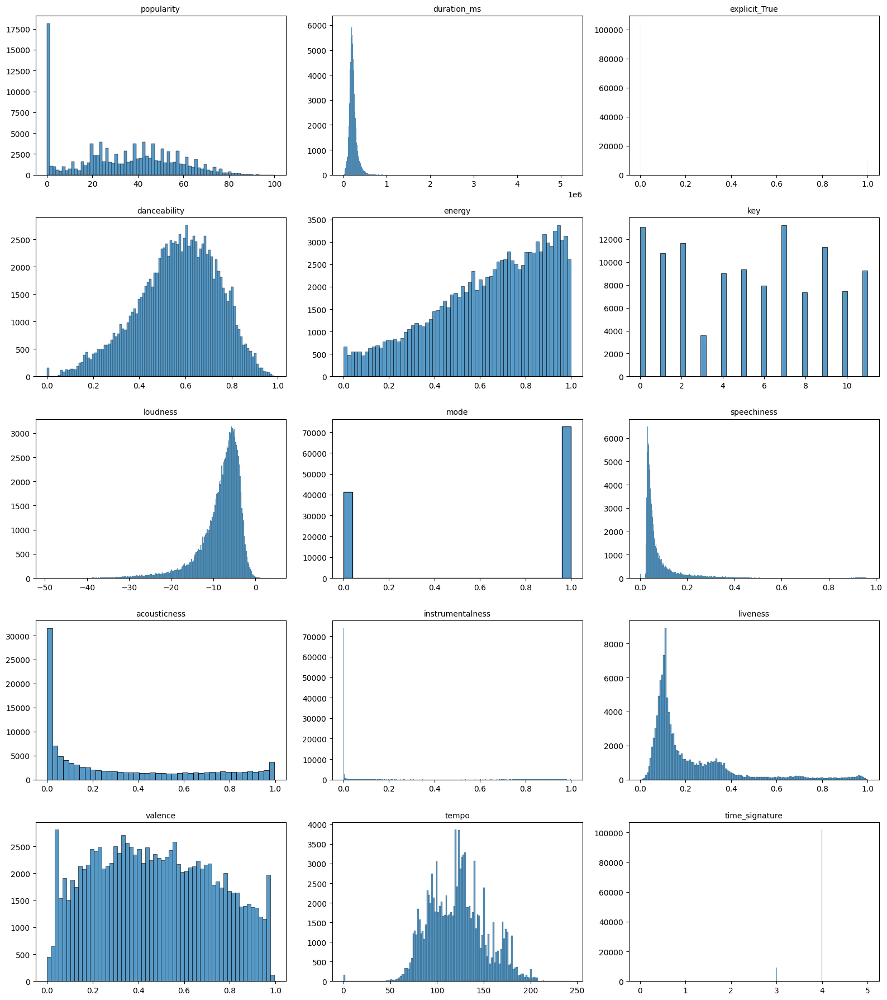

In [7]:
# Variable distribution
fig, axes = plt.subplots(5, 3, figsize=(16,18))
axes = axes.flatten()

for ax, col in zip(axes, df_no_genres.columns):
    sns.histplot(df_clean[col], ax = ax)
    ax.set_title(col, fontsize = 10)
    ax.set_xlabel("")
    ax.set_ylabel("")

plt.tight_layout()

Duration, speechiness, liveness, acousticness, instrumentalness appear to be right-skewed. As we want to implement PCA, it may be helpful to transform these variables for distribution symmetry.

## Principal Component Analysis (PCA)

Considering that there are 131 variables in our dataset, we decided to do PCA to reduce the dimensionality of our dataset for clustering, which works better in lower dimensions.

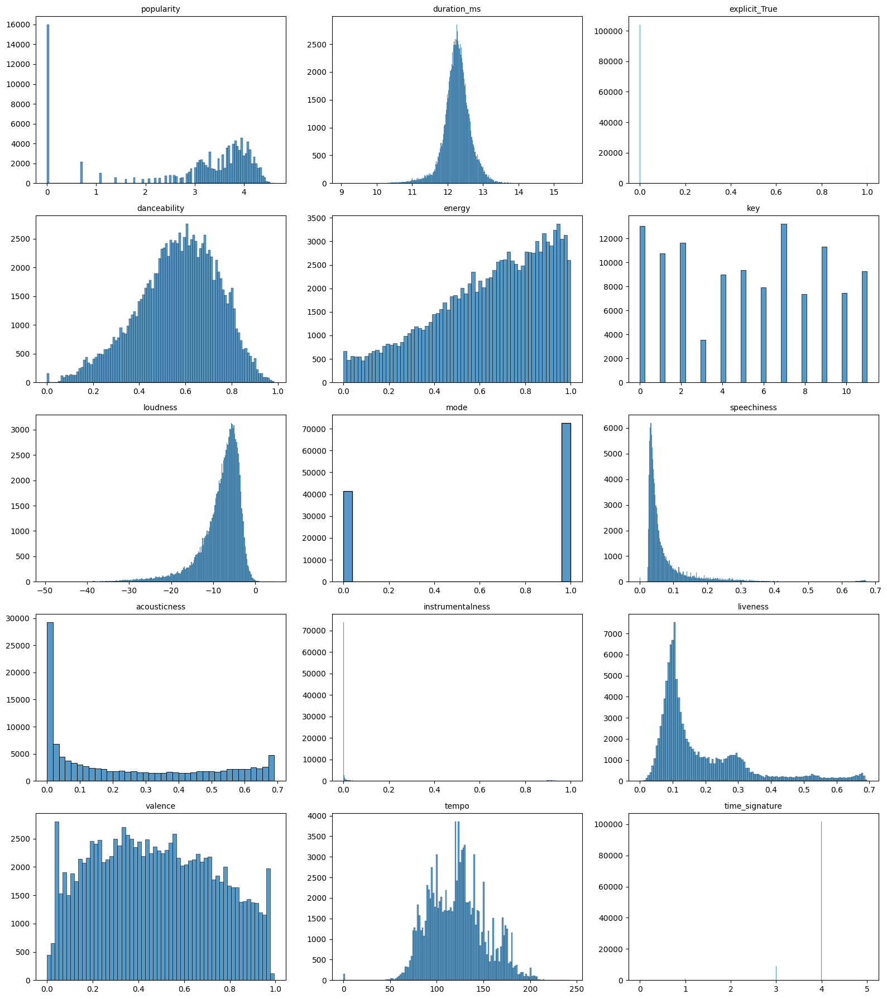

In [8]:
# Preprocessing: transform skewed variables
skew_cols = ["popularity", "duration_ms", "speechiness",
             "acousticness", "liveness"]
df_clean[skew_cols] = np.log1p(df_clean[skew_cols])

# Reobserving variable distribution
fig, axes = plt.subplots(5, 3, figsize=(16,18))
axes = axes.flatten()

for ax, col in zip(axes, df_no_genres.columns):
    sns.histplot(df_clean[col], ax = ax)
    ax.set_title(col, fontsize = 10)
    ax.set_xlabel("")
    ax.set_ylabel("")

plt.tight_layout()

Speechiness, loudness, and liveness still has significant non-symmetry, so we will try to cut off the tails by removing outliers.

In [9]:
def remove_outliers(df, cols):
    df = df.copy()

    for col in cols:
        x = df[col]
        q1 = np.quantile(x, 0.25)
        q3 = np.quantile(x, 0.75)
        mean = np.mean(x)
        iqr = q3 - q1

        # Only keep non outliers
        df = df[(df[col] >= q1 - 1.5 * iqr) & (df[col] <= q3 + 1.5 * iqr)]

    return df

df_removed = remove_outliers(df_clean, ["popularity", "speechiness", "loudness", "liveness"])

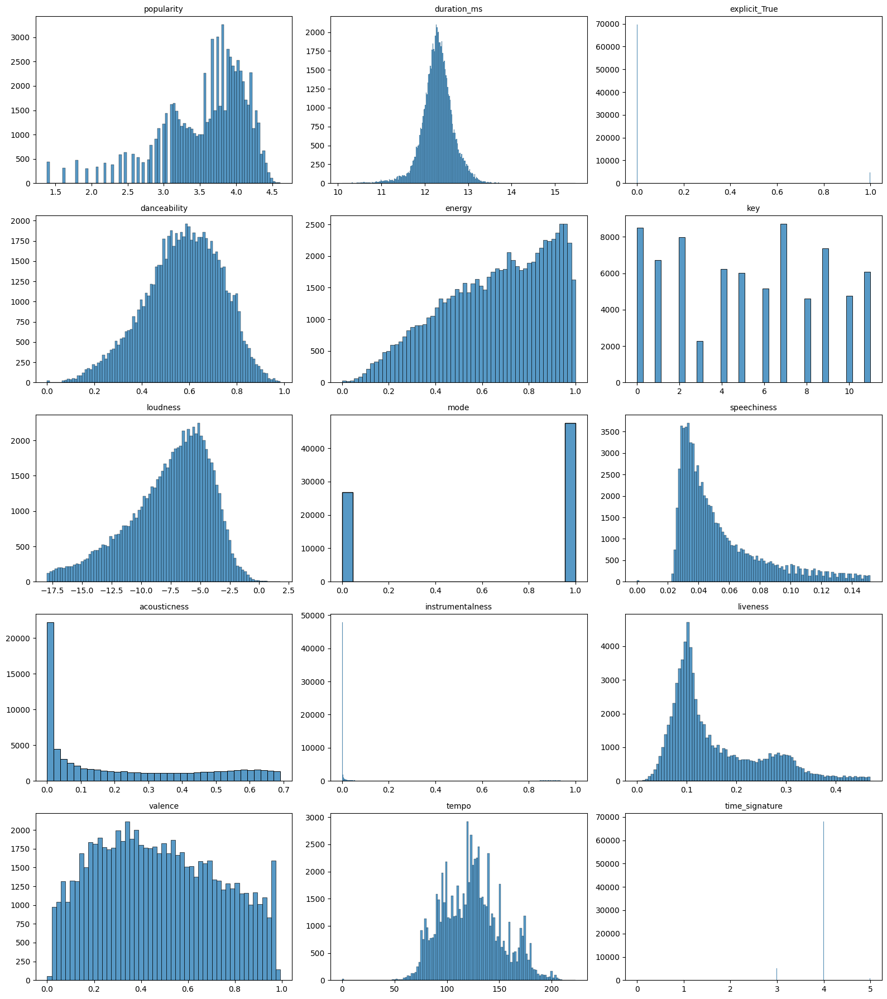

In [10]:
# Reobserving variable distribution
fig, axes = plt.subplots(5, 3, figsize=(16,18))
axes = axes.flatten()

for ax, col in zip(axes, df_no_genres.columns):
    sns.histplot(df_removed[col], ax = ax)
    ax.set_title(col, fontsize = 10)
    ax.set_xlabel("")
    ax.set_ylabel("")

plt.tight_layout()

In [11]:
# Preprocessing: standardizing
scaler = StandardScaler()

numeric = ['popularity', 'duration_ms', 'danceability', 'energy',
           'loudness', 'mode', 'speechiness', 'acousticness',
           'instrumentalness', 'liveness', 'valence', 'tempo']

# Only scaling the continuous numeric variables
df_scaled = pd.DataFrame(
    scaler.fit_transform(df_removed[numeric]),
    columns = numeric,
    index = df_removed.index
)

df_removed = pd.concat([df_removed.drop(columns = numeric), df_scaled], axis = 1)

In [12]:
df_removed.head()

,artists,album_name,track_name,key,time_signature,explicit_True,track_genre_afrobeat,track_genre_alt-rock,track_genre_alternative,track_genre_ambient,...,danceability,energy,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo
0,Gen Hoshino,Comedy,Comedy,1,4,0,0,0,0,0,...,0.643017,-0.859336,0.245904,-1.331268,2.823644,-0.833694,-0.506384,1.622247,0.929680,-1.260181
1,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,1,4,0,0,0,0,0,...,-0.948615,-2.144581,-2.793394,0.751163,0.688931,1.878402,-0.506368,-0.655780,-0.817450,-1.628880
2,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,0,4,0,0,0,0,0,...,-0.836703,-1.303725,-0.619901,0.751163,0.002823,-0.141518,-0.506387,-0.499119,-1.390727,-1.669787
4,Chord Overstreet,Hold On,Hold On,2,4,0,0,0,0,0,...,0.282413,-0.937757,-0.604543,0.751163,-0.101584,0.703240,-0.506387,-0.835771,-1.207434,-0.127637
5,Tyrone Wells,Days I Will Remember,Days I Will Remember,6,4,0,0,0,0,0,...,0.717624,-0.772200,-0.351293,0.751163,1.623240,0.133938,-0.506387,0.179163,0.738588,-0.903079


In [13]:
pca = PCA(n_components=20)
X_pca = pca.fit_transform(df_removed.drop(columns=["artists", "album_name", "track_name"]))
pc_var = pd.DataFrame({
    "PC": range(1, len(pca.explained_variance_ratio_) + 1),
    "var_explained": pca.explained_variance_ratio_,
    "cum_var_explained": pca.explained_variance_ratio_.cumsum(),
})
pc_var

,PC,var_explained,cum_var_explained
0,1,0.489902,0.489902
1,2,0.102052,0.591954
2,3,0.063653,0.655607
3,4,0.050280,0.705887
4,5,0.044778,0.750664
5,6,0.038487,0.789151
6,7,0.036191,0.825342
7,8,0.034098,0.859440
8,9,0.028754,0.888194
9,10,0.028048,0.916242


In [14]:
# Scree plot
px.line(x = pc_var["PC"], y = pc_var["var_explained"],
        labels = {"x": "PC",
                  "y": "Proportion explained"})

The scree plot above shows an elbow at around PC 2-5, so retaining up to the first 5 PCs would achieve dimensionality reduction while still preserving statistical information.

## K-means clustering

In [ ]:
# Choosing first 4 PCs
X_pca_subset = X_pca[:, :5]

silhouette_kmeans = []

# Trying 2 to 5 clusters
c_range = range(2, 6)

for c in c_range:
    kmeans = KMeans(n_clusters=c, n_init=10, random_state=42)
    y_kmeans = kmeans.fit_predict(X_pca_subset)
    silhouette_kmeans.append(silhouette_score(X_pca_subset, y_kmeans))

silhouette_kmeans

In [ ]:
# Best number of clusters
best_c = list(c_range)[int(np.argmax(silhouette_kmeans))]

# Fitting k-means with the best number of clusters
kmeans = KMeans(n_clusters=best_c, n_init=10, random_state=42)
y_kmeans = kmeans.fit_predict(X_pca_subset)

kmeans_df = pd.DataFrame(
    X_pca_subset[:, :5],
    columns=["PC1", "PC2", "PC3", "PC4", "PC5"]
)

kmeans_df["y"] = y_kmeans
kmeans_df["song"] = df_removed["track_name"].values
kmeans_df["album"] = df_removed["album_name"].values
kmeans_df["artist"] = df_removed["artists"].values

px.scatter_matrix(
    kmeans_df,
    dimensions=["PC1", "PC2", "PC3", "PC4", "PC5"],
    color="y",
    hover_data=["song", "album", "artist"]
)

In [ ]:
px.scatter_3d(
    kmeans_df,
    x="PC1",
    y="PC2",
    z="PC3",
    color="y",
    hover_data=["song", "album", "artist"]
)


## Hierarchical clustering

In [ ]:
# silhouette_hclust = []

# # Trying 2 to 5 clusters
# k_range = range(2, 6)

# # Random sample to fit hierarchical clustering
# # code here

# for k in k_range:
#     hclust = AgglomerativeClustering(n_clusters=k,
#                                      metric="euclidean",
#                                      linkage="ward")
    
#     y_hclust = hclust.fit_predict(X_pca_subset)
#     silhouette_hclust.append(silhouette_score(X_pca_subset, y_hclust))

# silhouette_hclust

## Clustering metrics

In [ ]:
# Total within sum of squares from lecture notes
def tot_within_sum_of_square(data, clusters):
    wss = 0
    unique_clusters = np.unique(clusters)

    for c in unique_clusters:
        points = data[clusters == c]
        centroid = points.mean(axis=0)
        wss += ((points - centroid)**2).sum()

    return(wss)

In [ ]:
values = [kmeans.inertia_,
          silhouette_score(X_pca_subset, y_kmeans)]
values = np.round(values, 2)

pd.DataFrame({
    "Metric": ["K-means inertia", "K-means WSS",
               "K-means silhouette"],
    "Value": values
})

NameError: name 'kmeans' is not defined

Write smth about comparing metrics